<a href="https://colab.research.google.com/github/kundajelab/adar_editing/blob/master/xgboost_with_shap/ALLSUBSTRATES_XGBOOST_WITH_TREESHAP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install numpy==1.15


    100% |████████████████████████████████| 13.9MB 2.5MB/s 
torchvision 0.2.1 has requirement pillow>=4.1.1, but you'll have pillow 4.0.0 which is incompatible.
thinc 6.12.1 has requirement wrapt<1.11.0,>=1.10.0, but you'll have wrapt 1.11.1 which is incompatible.
pymc3 3.6 has requirement joblib<0.13.0, but you'll have joblib 0.13.2 which is incompatible.
featuretools 0.4.1 has requirement pandas>=0.23.0, but you'll have pandas 0.22.0 which is incompatible.
albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.8 which is incompatible.
  Found existing installation: numpy 1.14.6
    Uninstalling numpy-1.14.6:
      Successfully uninstalled numpy-1.14.6


In [1]:

## Uncomment these lines if running as a google colab notebook: 
! git clone https://github.com/kundajelab/adar_editing
import os
os.chdir("adar_editing/xgboost_with_shap/")
!pip install shap
!pip install --upgrade xgboost
!pip install cufflinks


Cloning into 'adar_editing'...
remote: Enumerating objects: 97, done.
remote: Counting objects: 100% (97/97), done.
remote: Compressing objects: 100% (76/76), done.
remote: Total 460 (delta 63), reused 39 (delta 21), pack-reused 363
Receiving objects: 100% (460/460), 51.41 MiB | 11.78 MiB/s, done.
Resolving deltas: 100% (260/260), done.
    100% |████████████████████████████████| 225kB 7.6MB/s 
  Stored in directory: /root/.cache/pip/wheels/bf/26/bd/912db1314f1cef0171d9b7f128dd01e8b8c92ed8d0062e632d
Successfully built shap
    100% |████████████████████████████████| 16.6MB 2.0MB/s 
  Found existing installation: xgboost 0.7.post4
    Uninstalling xgboost-0.7.post4:
      Successfully uninstalled xgboost-0.7.post4


In [1]:
%load_ext autoreload
%autoreload 2   

In [2]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))


In [3]:
#helper utilities for model training and interpretation 
import shap
from helpers import * 

#set a random seed so code is reproducible 
random.seed(1234)

# load JS visualization code to notebook
shap.initjs()
import warnings
warnings.filterwarnings('ignore')

#visualization utilities 
import matplotlib
import matplotlib.pyplot as plt 
%matplotlib inline
import plotly.plotly as py
import numpy as np
from plotly.offline import iplot
from plotly.graph_objs import Heatmap


/users/annashch/miniconda3/lib/python3.6/site-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d



## Substrates combined, xgboost with TreeShap <a name='outline'>
<ol>
    <li><a href=#1>All features</a></li>
    <li><a href=#2>Feature subsets</a></li>
 </ol>


## All features<a name='1'>
<a href=#outline>Home</a>

In [4]:
## Read in the data 
import pandas as pd 
data_neil_degen=pd.read_csv("../xin_feature_matrices/neil1_degenerate_computational.features.csv",header=0,sep=',',index_col=0)

#remove any null editing level values 
data_neil_degen=data_neil_degen[~data_neil_degen["editing_value"].isnull().values]
## prepare data for training with xgboost 
data_neil_degen=format_for_xgboost(data_neil_degen)
train_split1,eval_split1,test_split1=split_train_test_eval_by_mut_pos(data_neil_degen[~data_neil_degen['mut_pos'].isna()])
null_mut_pos=data_neil_degen[data_neil_degen['mut_pos'].isna()]
train_split1=pd.concat((train_split1,null_mut_pos),axis=0)

train_split1['dataset']="NEIL1_DEGEN"
eval_split1['dataset']="NEIL1_DEGEN"
test_split1['dataset']="NEIL1_DEGEN"


(856, 207)
{44.0: 98, 45.0: 155, 46.0: 124, 48.0: 160, 49.0: 79, 50.0: 97, 51.0: 12, 52.0: 12, 53.0: 10, 54.0: 108}


In [5]:
data_neil_comp=pd.read_csv("../xin_feature_matrices/neil1_computational.features.csv",header=0,sep=',',index_col=0)
#remove any null editing level values 
data_neil_comp=data_neil_comp[~data_neil_comp["editing_value"].isnull().values]
## prepare data for training with xgboost 
data_neil_comp=format_for_xgboost(data_neil_comp)
train_split2,eval_split2,test_split2=split_train_test_eval_by_mut_pos(data_neil_comp[~data_neil_comp['mut_pos'].isna()])
null_mut_pos=data_neil_comp[data_neil_comp['mut_pos'].isna()]
train_split2=pd.concat((train_split2,null_mut_pos),axis=0)

train_split2['dataset']="NEIL1_COMP"
eval_split2['dataset']="NEIL1_COMP"
test_split2['dataset']="NEIL1_COMP"

(428, 218)
{20.0: 3, 21.0: 3, 22.0: 3, 23.0: 4, 24.0: 3, 25.0: 4, 26.0: 3, 27.0: 4, 28.0: 4, 29.0: 4, 30.0: 3, 31.0: 4, 32.0: 4, 33.0: 4, 34.0: 4, 35.0: 4, 36.0: 4, 41.0: 20, 42.0: 21, 43.0: 18, 44.0: 18, 45.0: 20, 46.0: 19, 48.0: 20, 49.0: 21, 50.0: 21, 51.0: 20, 52.0: 20, 53.0: 21, 54.0: 19, 55.0: 21, 56.0: 20, 57.0: 15, 58.0: 31}


In [6]:
data_ttyh2_degen=pd.read_csv("../xin_feature_matrices/ttyh2_bc_degenerate_computational.features.csv",header=0,sep=',',index_col=0)
#remove any null editing level values 
data_ttyh2_degen=data_ttyh2_degen[~data_ttyh2_degen["editing_value"].isnull().values]
## prepare data for training with xgboost 
data_ttyh2_degen=format_for_xgboost(data_ttyh2_degen)
train_split3,eval_split3,test_split3=split_train_test_eval_by_mut_pos(data_ttyh2_degen[~data_ttyh2_degen['mut_pos'].isna()])
null_mut_pos=data_ttyh2_degen[data_ttyh2_degen['mut_pos'].isna()]
train_split3=pd.concat((train_split3,null_mut_pos),axis=0)
train_split3['dataset']="TTYH2_DEGEN"
eval_split3['dataset']="TTYH2_DEGEN"
test_split3['dataset']="TTYH2_DEGEN"


(363, 171)
{24.0: 32, 25.0: 33, 26.0: 41, 27.0: 42, 28.0: 31, 29.0: 23, 30.0: 24, 31.0: 34, 32.0: 25, 33.0: 21, 48.0: 56}


In [7]:
data_ttyh2_comp=pd.read_csv("../xin_feature_matrices/ttyh2_computational.features.csv",header=0,sep=',',index_col=0)
#remove any null editing level values 
data_ttyh2_comp=data_ttyh2_comp[~data_ttyh2_comp["editing_value"].isnull().values]
## prepare data for training with xgboost 
data_ttyh2_comp=format_for_xgboost(data_ttyh2_comp)
train_split4,eval_split4,test_split4=split_train_test_eval_by_mut_pos(data_ttyh2_comp[~data_ttyh2_comp['mut_pos'].isna()])
null_mut_pos=data_ttyh2_comp[data_ttyh2_comp['mut_pos'].isna()]
train_split4=pd.concat((train_split4,null_mut_pos),axis=0)

train_split4['dataset']="TTYH2_COMP"
eval_split4['dataset']="TTYH2_COMP"
test_split4['dataset']="TTYH2_COMP"



(601, 215)
{21.0: 18, 22.0: 18, 23.0: 18, 24.0: 20, 25.0: 17, 26.0: 20, 27.0: 20, 28.0: 20, 29.0: 18, 30.0: 18, 31.0: 17, 32.0: 17, 33.0: 17, 34.0: 18, 35.0: 18, 36.0: 18, 79.0: 17, 80.0: 17, 81.0: 18, 82.0: 18, 83.0: 19, 84.0: 19, 85.0: 20, 86.0: 29, 88.0: 27, 89.0: 18, 90.0: 17, 91.0: 17, 92.0: 17, 93.0: 14, 94.0: 36}


In [8]:
data_ajuba=pd.read_csv("../xin_feature_matrices/ajuba_bc_computational.features.csv",header=0,sep=',',index_col=0)
#remove any null editing level values 
data_ajuba=data_ajuba[~data_ajuba["editing_value"].isnull().values]
## prepare data for training with xgboost 
data_ajuba=format_for_xgboost(data_ajuba)
train_split5,eval_split5,test_split5=split_train_test_eval_by_mut_pos(data_ajuba[~data_ajuba['mut_pos'].isna()])
null_mut_pos=data_ajuba[data_ajuba['mut_pos'].isna()]
train_split5=pd.concat((train_split5,null_mut_pos),axis=0)

train_split5['dataset']="AJUBA"
eval_split5['dataset']="AJUBA"
test_split5['dataset']="AJUBA"


(482, 185)
{64.0: 22, 65.0: 21, 66.0: 22, 67.0: 22, 68.0: 22, 69.0: 23, 70.0: 23, 71.0: 24, 72.0: 23, 73.0: 33, 75.0: 33, 76.0: 24, 77.0: 24, 78.0: 23, 79.0: 23, 80.0: 22, 81.0: 22, 82.0: 22, 83.0: 44}


In [9]:
train_split=pd.concat([train_split1,train_split2,train_split3,train_split4,train_split5])
eval_split=pd.concat([eval_split1,eval_split2,eval_split3,eval_split4,eval_split5])
test_split=pd.concat([test_split1,test_split2,test_split3,test_split4,test_split5])

train_split.reset_index(inplace=True, drop=True) 
eval_split.reset_index(inplace=True,drop=True)
test_split.reset_index(inplace=True,drop=True)

In [10]:
train_dataset=train_split['dataset']
eval_dataset=eval_split['dataset']
test_dataset=test_split['dataset']

In [11]:
#Remove any non-varying features 
train_novar=get_singleval_features(train_split)
eval_novar=get_singleval_features(eval_split)
test_novar=get_singleval_features(test_split)
uniform_features_to_drop=list(set(train_novar+eval_novar+test_novar))

In [12]:
#Remove any null features 
train_null=get_all_null_features(train_split)
eval_null=get_all_null_features(eval_split)
test_null=get_all_null_features(test_split)
null_features_to_drop=list(set(train_null+eval_null+test_null))

In [13]:
to_drop=list(set(uniform_features_to_drop+null_features_to_drop))
to_drop.append('dataset')
print("\n".join(to_drop))

d1_length_hairpin
d2_5prm_cp_bulge
d2_3prm_cp_bulge
d1_5prm_cp_bulge
d1_5prm_cp_hairpin
u1_length_internal_ecs
d1_3prm_cp_bulge
d2_exist
d2_length_hairpin
mut_exist
u2_5prm_cp_internal
u1_5prm_cp_hairpin
mut_type:wt
site_5prm_cp_hairpin
u3_5prm_cp_internal
u2_exist
u1_exist
u1_length_internal_es
d3_3prm_cp_internal
u3_length_internal_ecs
mut_same_as_site
d1_exist
d3_5prm_cp_hairpin
u2_length_internal_ecs
d3_5prm_cp_bulge
u3_length_internal_es
u1_3prm_cp_internal
u2_length_internal_es
mut_type:mismatch
u3_3prm_cp_internal
d2_5prm_cp_hairpin
d3_length_hairpin
d3_5prm_cp_internal
u2_3prm_cp_internal
d3_3prm_cp_bulge
u1_5prm_cp_internal
dataset


In [14]:
#remove teh features that don't change across isoforms , or are null for all isoforms
train_split=train_split.drop(to_drop,axis=1)
eval_split=eval_split.drop(to_drop,axis=1)
test_split=test_split.drop(to_drop,axis=1)

In [15]:

train_y=train_split['editing_value']
train_X=train_split.drop(['editing_value'],axis=1)
eval_y=eval_split['editing_value']
eval_X=eval_split.drop(['editing_value'],axis=1)
test_y=test_split['editing_value']
test_X=test_split.drop(['editing_value'],axis=1)

In [16]:
print(train_X.shape)
print(train_y.shape)
print(eval_X.shape)
print(eval_y.shape)
print(test_X.shape)
print(test_y.shape)


(1741, 245)
(1741,)
(342, 245)
(342,)
(476, 245)
(476,)


In [17]:
## format matrixes for xgboost 
import xgboost
dtrain=xgboost.DMatrix(train_X,train_y)
deval=xgboost.DMatrix(eval_X,eval_y)
dtest=xgboost.DMatrix(test_X,test_y)

In [18]:
## set model training parameters 
from __future__ import unicode_literals
param=dict() 
param['nthread'] = 20
#rmse -- root mean square error 
# mae -- mean absolute error 
# map -- mean average precision 
# auc -- area under ROC curve 
# aucpr -- area under precision recall curve 

#Note: the last metric in your 'eval_metric' list will get optimized 
param['eval_metric'] = ['aucpr','auc','mae','map','rmse']

In [19]:
evallist = [(deval, 'eval'), (dtrain, 'train')]


In [20]:
num_round = 1000
bst = xgboost.train(param, dtrain, num_round, evallist,early_stopping_rounds=10)

[13:23:42] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 80 extra nodes, 0 pruned nodes, max_depth=6
[0]	eval-aucpr:0.460565	eval-auc:0.858893	eval-mae:0.285132	eval-map:1	eval-rmse:0.303132	train-aucpr:0.510686	train-auc:0.866737	train-mae:0.287877	train-map:1	train-rmse:0.304391
Multiple eval metrics have been passed: 'train-rmse' will be used for early stopping.

Will train until train-rmse hasn't improved in 10 rounds.
[13:23:42] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 90 extra nodes, 0 pruned nodes, max_depth=6
[1]	eval-aucpr:0.484506	eval-auc:0.878979	eval-mae:0.204975	eval-map:1	eval-rmse:0.218763	train-aucpr:0.542529	train-auc:0.887214	train-mae:0.205974	train-map:1	train-rmse:0.218971
[13:23:42] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 100 extra nodes, 0 pruned nodes, max_depth=6
[2]	eval-aucpr:0.491196	eval-auc:0.882792	eval-mae:0.15119	eval-map:1	eval-rmse:0.162852	train-aucpr:0.549315	train-auc:0.8

[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 58 extra nodes, 0 pruned nodes, max_depth=6
[27]	eval-aucpr:0.509769	eval-auc:0.895011	eval-mae:0.033584	eval-map:1	eval-rmse:0.062453	train-aucpr:0.57333	train-auc:0.906367	train-mae:0.017646	train-map:1	train-rmse:0.031439
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 52 extra nodes, 0 pruned nodes, max_depth=6
[28]	eval-aucpr:0.509913	eval-auc:0.895523	eval-mae:0.033473	eval-map:1	eval-rmse:0.062322	train-aucpr:0.573453	train-auc:0.906735	train-mae:0.017465	train-map:1	train-rmse:0.031213
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 42 extra nodes, 0 pruned nodes, max_depth=6
[29]	eval-aucpr:0.511156	eval-auc:0.895437	eval-mae:0.033272	eval-map:1	eval-rmse:0.06237	train-aucpr:0.573636	train-auc:0.90681	train-mae:0.017244	train-map:1	train-rmse:0.03093
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 46 extra n

[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 76 extra nodes, 0 pruned nodes, max_depth=6
[54]	eval-aucpr:0.512845	eval-auc:0.896592	eval-mae:0.030863	eval-map:1	eval-rmse:0.059676	train-aucpr:0.57887	train-auc:0.909184	train-mae:0.011208	train-map:1	train-rmse:0.020363
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 72 extra nodes, 0 pruned nodes, max_depth=6
[55]	eval-aucpr:0.512938	eval-auc:0.896587	eval-mae:0.030891	eval-map:1	eval-rmse:0.059647	train-aucpr:0.578992	train-auc:0.909226	train-mae:0.011079	train-map:1	train-rmse:0.020123
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 54 extra nodes, 0 pruned nodes, max_depth=6
[56]	eval-aucpr:0.512971	eval-auc:0.896707	eval-mae:0.030777	eval-map:1	eval-rmse:0.059523	train-aucpr:0.579072	train-auc:0.909338	train-mae:0.010921	train-map:1	train-rmse:0.019873
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 48 extr

[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 40 extra nodes, 0 pruned nodes, max_depth=6
[81]	eval-aucpr:0.515282	eval-auc:0.897565	eval-mae:0.029064	eval-map:1	eval-rmse:0.057483	train-aucpr:0.581017	train-auc:0.910325	train-mae:0.007768	train-map:1	train-rmse:0.014229
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 86 extra nodes, 0 pruned nodes, max_depth=6
[82]	eval-aucpr:0.515595	eval-auc:0.897578	eval-mae:0.028927	eval-map:1	eval-rmse:0.05727	train-aucpr:0.581196	train-auc:0.910415	train-mae:0.007544	train-map:1	train-rmse:0.013674
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 76 extra nodes, 0 pruned nodes, max_depth=6
[83]	eval-aucpr:0.515723	eval-auc:0.897513	eval-mae:0.028898	eval-map:1	eval-rmse:0.057177	train-aucpr:0.58125	train-auc:0.910432	train-mae:0.00744	train-map:1	train-rmse:0.013397
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 92 extra 

[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 60 extra nodes, 0 pruned nodes, max_depth=6
[108]	eval-aucpr:0.516736	eval-auc:0.897558	eval-mae:0.028334	eval-map:1	eval-rmse:0.056639	train-aucpr:0.582344	train-auc:0.910905	train-mae:0.005572	train-map:1	train-rmse:0.010129
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 60 extra nodes, 0 pruned nodes, max_depth=6
[109]	eval-aucpr:0.516741	eval-auc:0.897557	eval-mae:0.028341	eval-map:1	eval-rmse:0.056638	train-aucpr:0.582417	train-auc:0.91092	train-mae:0.005518	train-map:1	train-rmse:0.010067
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 84 extra nodes, 0 pruned nodes, max_depth=6
[110]	eval-aucpr:0.516463	eval-auc:0.896913	eval-mae:0.028855	eval-map:1	eval-rmse:0.056806	train-aucpr:0.582469	train-auc:0.910946	train-mae:0.005417	train-map:1	train-rmse:0.009785
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 44 e

[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 76 extra nodes, 0 pruned nodes, max_depth=6
[135]	eval-aucpr:0.517037	eval-auc:0.897242	eval-mae:0.028447	eval-map:1	eval-rmse:0.056341	train-aucpr:0.58287	train-auc:0.911232	train-mae:0.004265	train-map:1	train-rmse:0.007556
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 48 extra nodes, 0 pruned nodes, max_depth=6
[136]	eval-aucpr:0.517035	eval-auc:0.897235	eval-mae:0.02845	eval-map:1	eval-rmse:0.056342	train-aucpr:0.582871	train-auc:0.911236	train-mae:0.004246	train-map:1	train-rmse:0.007544
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 54 extra nodes, 0 pruned nodes, max_depth=6
[137]	eval-aucpr:0.517045	eval-auc:0.897244	eval-mae:0.028431	eval-map:1	eval-rmse:0.056326	train-aucpr:0.582875	train-auc:0.911245	train-mae:0.004211	train-map:1	train-rmse:0.007508
[13:23:43] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 70 ex

[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 82 extra nodes, 0 pruned nodes, max_depth=6
[162]	eval-aucpr:0.516763	eval-auc:0.897177	eval-mae:0.028322	eval-map:1	eval-rmse:0.056228	train-aucpr:0.583089	train-auc:0.911428	train-mae:0.003347	train-map:1	train-rmse:0.005979
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 80 extra nodes, 0 pruned nodes, max_depth=6
[163]	eval-aucpr:0.516998	eval-auc:0.897459	eval-mae:0.028286	eval-map:1	eval-rmse:0.056239	train-aucpr:0.583094	train-auc:0.911434	train-mae:0.003311	train-map:1	train-rmse:0.005939
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 92 extra nodes, 0 pruned nodes, max_depth=6
[164]	eval-aucpr:0.517539	eval-auc:0.897124	eval-mae:0.028636	eval-map:1	eval-rmse:0.05631	train-aucpr:0.583101	train-auc:0.911439	train-mae:0.003249	train-map:1	train-rmse:0.005867
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 40 e

[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 36 extra nodes, 0 pruned nodes, max_depth=6
[189]	eval-aucpr:0.517752	eval-auc:0.897198	eval-mae:0.028465	eval-map:1	eval-rmse:0.056209	train-aucpr:0.583229	train-auc:0.911564	train-mae:0.002591	train-map:1	train-rmse:0.004792
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 68 extra nodes, 0 pruned nodes, max_depth=6
[190]	eval-aucpr:0.517695	eval-auc:0.897164	eval-mae:0.028446	eval-map:1	eval-rmse:0.056204	train-aucpr:0.583238	train-auc:0.91157	train-mae:0.002553	train-map:1	train-rmse:0.004706
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 72 extra nodes, 0 pruned nodes, max_depth=6
[191]	eval-aucpr:0.517692	eval-auc:0.897153	eval-mae:0.028448	eval-map:1	eval-rmse:0.056206	train-aucpr:0.583239	train-auc:0.911572	train-mae:0.002534	train-map:1	train-rmse:0.004689
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 66 e

[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 44 extra nodes, 0 pruned nodes, max_depth=6
[216]	eval-aucpr:0.518715	eval-auc:0.897263	eval-mae:0.028362	eval-map:1	eval-rmse:0.056295	train-aucpr:0.583314	train-auc:0.911648	train-mae:0.002014	train-map:1	train-rmse:0.003856
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 62 extra nodes, 0 pruned nodes, max_depth=6
[217]	eval-aucpr:0.518712	eval-auc:0.897264	eval-mae:0.028359	eval-map:1	eval-rmse:0.056298	train-aucpr:0.583317	train-auc:0.911652	train-mae:0.001991	train-map:1	train-rmse:0.003828
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 56 extra nodes, 0 pruned nodes, max_depth=6
[218]	eval-aucpr:0.518709	eval-auc:0.897255	eval-mae:0.02836	eval-map:1	eval-rmse:0.056299	train-aucpr:0.583318	train-auc:0.911654	train-mae:0.001977	train-map:1	train-rmse:0.00381
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 38 ex

[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 96 extra nodes, 0 pruned nodes, max_depth=6
[243]	eval-aucpr:0.518788	eval-auc:0.897347	eval-mae:0.028237	eval-map:1	eval-rmse:0.056329	train-aucpr:0.58336	train-auc:0.9117	train-mae:0.001591	train-map:1	train-rmse:0.003242
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 58 extra nodes, 0 pruned nodes, max_depth=6
[244]	eval-aucpr:0.518788	eval-auc:0.897348	eval-mae:0.028235	eval-map:1	eval-rmse:0.056329	train-aucpr:0.583365	train-auc:0.911701	train-mae:0.001578	train-map:1	train-rmse:0.003224
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 42 extra nodes, 0 pruned nodes, max_depth=6
[245]	eval-aucpr:0.518755	eval-auc:0.897337	eval-mae:0.028242	eval-map:1	eval-rmse:0.05635	train-aucpr:0.583367	train-auc:0.911702	train-mae:0.001569	train-map:1	train-rmse:0.003213
[13:23:44] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 46 extr

In [21]:
# save to binary file for faster loading
bst.save_model('combined.substrates.model')
# save model to text file 
bst.dump_model('combined.substrates.txt')


In [22]:
## get model predictions on the test, training, and eval splits 
test_pred = bst.predict(dtest)
train_pred=bst.predict(dtrain)
eval_pred=bst.predict(deval)

In [23]:
## get performance on Neil1 comp subset 
from helpers import * 
cur_split="NEIL1_COMP"
train_subset=train_dataset==cur_split
eval_subset=eval_dataset==cur_split
test_subset=test_dataset==cur_split
print_aggregate_peformance_metrics(train_y[train_subset],train_pred[train_subset],
                                   eval_y[eval_subset],eval_pred[eval_subset],
                                   test_y[test_subset],test_pred[test_subset],
                                   positive_thresh=0.2)

Train
	Spearman corr : SpearmanrResult(correlation=0.9987283470400367, pvalue=0.0)
	Pearson corr : (0.9996749068466376, 0.0)
	MAE : 0.0027284371769755815
	MAPE : 0.03539369400317357
	RMSE : 0.005993577164653361
	auPRC : 1.0
	auROC : 0.9993114909781576
Eval
	Spearman corr : SpearmanrResult(correlation=0.9253127532896874, pvalue=3.989689133585923e-23)
	Pearson corr : (0.9299263152576621, 8.303191352223583e-24)
	MAE : 0.06207289794108497
	MAPE : 0.337600936368833
	RMSE : 0.09216836247819857
	auPRC : 0.9924596157354777
	auROC : 0.9870689655172413
Test
	Spearman corr : SpearmanrResult(correlation=0.9195730434441957, pvalue=1.7774011612229345e-28)
	Pearson corr : (0.940997483126156, 9.113059455578446e-33)
	MAE : 0.05652641394909691
	MAPE : 0.4157609003817717
	RMSE : 0.07783997963503898
	auPRC : 0.9721892120005292
	auROC : 0.9735930735930736


In [24]:
## get performance on Neil1 degen subset 
from helpers import * 
cur_split="NEIL1_DEGEN"
train_subset=train_dataset==cur_split
eval_subset=eval_dataset==cur_split
test_subset=test_dataset==cur_split
print_aggregate_peformance_metrics(train_y[train_subset],train_pred[train_subset],
                                   eval_y[eval_subset],eval_pred[eval_subset],
                                   test_y[test_subset],test_pred[test_subset],
                                   positive_thresh=0.2)

Train
	Spearman corr : SpearmanrResult(correlation=0.8419411852094127, pvalue=3.3802145887302142e-134)
	Pearson corr : (0.9999383245745851, 0.0)
	MAE : 0.0011906794845305824
	MAPE : 0.06298807766578335
	RMSE : 0.0024977888084559787
	auPRC : 0.9999999999999998
	auROC : 1.0
Eval
	Spearman corr : SpearmanrResult(correlation=0.5317207576834968, pvalue=1.7629464168437588e-08)
	Pearson corr : (0.9687848886420145, 5.945493499813417e-60)
	MAE : 0.011689861786602852
	MAPE : 0.5898578591726512
	RMSE : 0.031812014550402244
	auPRC : 1.0
	auROC : 1.0
Test
	Spearman corr : SpearmanrResult(correlation=0.5654694520253865, pvalue=1.69674873599447e-15)
	Pearson corr : (0.9800650676978165, 9.895827119585293e-118)
	MAE : 0.018433523225213244
	MAPE : 0.7745246069160905
	RMSE : 0.043098567265120145
	auPRC : 0.9999999999999999
	auROC : 1.0


In [25]:
## get performance on TTYH2 comp subset 
from helpers import * 
cur_split="TTYH2_COMP"
train_subset=train_dataset==cur_split
eval_subset=eval_dataset==cur_split
test_subset=test_dataset==cur_split
print_aggregate_peformance_metrics(train_y[train_subset],train_pred[train_subset],
                                   eval_y[eval_subset],eval_pred[eval_subset],
                                   test_y[test_subset],test_pred[test_subset],
                                   positive_thresh=0.2)

Train
	Spearman corr : SpearmanrResult(correlation=0.999569351549381, pvalue=0.0)
	Pearson corr : (0.9998574787564747, 0.0)
	MAE : 0.0015053194522883207
	MAPE : 0.02071770945298478
	RMSE : 0.0022330543603417585
	auPRC : 0.9999191175753144
	auROC : 0.9999477915840034
Eval
	Spearman corr : SpearmanrResult(correlation=0.9145653417564755, pvalue=9.412877177602338e-37)
	Pearson corr : (0.8725529310517964, 1.9690000753292827e-29)
	MAE : 0.0381540315325062
	MAPE : 0.36482796899235514
	RMSE : 0.06347410655651452
	auPRC : 0.9209834068735829
	auROC : 0.9486228813559321
Test
	Spearman corr : SpearmanrResult(correlation=0.9204698394714355, pvalue=4.430578743310019e-38)
	Pearson corr : (0.9264899632353092, 1.523864692956158e-39)
	MAE : 0.030864739727187937
	MAPE : 0.3856879467029563
	RMSE : 0.05024069645201149
	auPRC : 0.9084277749136888
	auROC : 0.9668367346938775


In [26]:
## get performance on TTYH2 Degen subset 
from helpers import * 
cur_split="TTYH2_DEGEN"
train_subset=train_dataset==cur_split
eval_subset=eval_dataset==cur_split
test_subset=test_dataset==cur_split
print_aggregate_peformance_metrics(train_y[train_subset],train_pred[train_subset],
                                   eval_y[eval_subset],eval_pred[eval_subset],
                                   test_y[test_subset],test_pred[test_subset],
                                   positive_thresh=0.2)

Train
	Spearman corr : SpearmanrResult(correlation=0.9892277887635365, pvalue=1.4346600646472123e-180)
	Pearson corr : (0.9999627908869014, 0.0)
	MAE : 0.0007455625868298948
	MAPE : 0.025346622420926133
	RMSE : 0.0013685317717127123
	auPRC : 0.9999999999999999
	auROC : 1.0
Eval
	Spearman corr : SpearmanrResult(correlation=0.7896164761763951, pvalue=7.827780082791177e-13)
	Pearson corr : (0.9779182537581641, 1.031567580963214e-37)
	MAE : 0.017602101535756483
	MAPE : 0.18893007280250287
	RMSE : 0.047328226922224166
	auPRC : 0.9999999999999998
	auROC : 1.0
Test
	Spearman corr : SpearmanrResult(correlation=0.7902530628758562, pvalue=9.379160607190347e-17)
	Pearson corr : (0.9890532568735375, 9.462202860381829e-61)
	MAE : 0.008962017768049894
	MAPE : 0.17623445650723027
	RMSE : 0.022466728241297997
	auPRC : 0.9999999999999998
	auROC : 1.0


In [29]:
## get performance on AJUBA subset 
from helpers import * 
cur_split="AJUBA"
train_subset=train_dataset==cur_split
eval_subset=eval_dataset==cur_split
test_subset=test_dataset==cur_split
print_aggregate_peformance_metrics(train_y[train_subset],train_pred[train_subset],
                                   eval_y[eval_subset],eval_pred[eval_subset],
                                   test_y[test_subset],test_pred[test_subset],
                                   positive_thresh=0.07)

Train
	Spearman corr : SpearmanrResult(correlation=0.9943593444187987, pvalue=0.0)
	Pearson corr : (0.9993097865412695, 0.0)
	MAE : 0.0015070402031367358
	MAPE : 0.04788808252949589
	RMSE : 0.002115013330835059
	auPRC : 0.998270686053429
	auROC : 0.9999195624195624
Eval
	Spearman corr : SpearmanrResult(correlation=0.7799670934087004, pvalue=2.7035324664349495e-10)
	Pearson corr : (0.8627754877483645, 2.551289421204514e-14)
	MAE : 0.016586395361098565
	MAPE : 0.4685888534892706
	RMSE : 0.03216276892830068
	auPRC : 1.0
	auROC : 1.0
Test
	Spearman corr : SpearmanrResult(correlation=0.811775547275183, pvalue=3.3878141954826046e-19)
	Pearson corr : (0.8056979365815099, 9.905712325393623e-19)
	MAE : 0.018824785653646887
	MAPE : 0.34012512590345645
	RMSE : 0.043256241973303015
	auPRC : 1.0
	auROC : 1.0


In [26]:
## Correlation values 
from scipy.stats import spearmanr,pearsonr
spearman_train=spearmanr(train_y,train_pred)
spearman_eval=spearmanr(eval_y,eval_pred)
spearman_test=spearmanr(test_y,test_pred)

pearson_train=pearsonr(train_y,train_pred)
pearson_eval=pearsonr(eval_y,eval_pred)
pearson_test=pearsonr(test_y,test_pred)

print("Spearman correlation:")
print("Train:"+str(spearman_train))
print("Eval:"+str(spearman_eval))
print("Test:"+str(spearman_test))
print("\n")
print("Pearson correlation:")
print("Train:"+str(pearson_train))
print("Eval:"+str(pearson_eval))
print("Test:"+str(pearson_test))

Spearman correlation:
Train:SpearmanrResult(correlation=0.9918594179235418, pvalue=0.0)
Eval:SpearmanrResult(correlation=0.9240323714772285, pvalue=4.9310277010865346e-144)
Test:SpearmanrResult(correlation=0.8831977929159958, pvalue=5.672083010859824e-158)


Pearson correlation:
Train:(0.9998623457453496, 0.0)
Eval:(0.9546529446118351, 5.63767123893405e-181)
Test:(0.9660397736278016, 1.0003758243430337e-280)


In [27]:
## MAE
from sklearn.metrics import mean_absolute_error
mae_train=mean_absolute_error(train_y,train_pred)
print("MAE Train:"+str(mae_train))

mae_eval=mean_absolute_error(eval_y,eval_pred)
print("MAE Eval:"+str(mae_eval))

mae_test=mean_absolute_error(test_y,test_pred)
print("MAE Test:"+str(mae_test))


MAE Train:0.0015263732171887556
MAE Eval:0.02813447453549324
MAE Test:0.024862650493112932


In [28]:
## MAPE
pseudocount=0.01
mape_train=np.mean(np.abs((train_y - train_pred) /(pseudocount+train_y))) * 100
print("MAPE Train:"+str(mape_train)+"%")

mape_eval=np.mean(np.abs((eval_y - eval_pred) /(pseudocount+eval_y))) * 100
print("MAPE Eval:"+str(mape_eval)+"%")

mape_test=np.mean(np.abs((test_y - test_pred) /(pseudocount+test_y))) * 100
print("MAPE Test:"+str(mape_test)+"%")

MAPE Train:4.103820059047837%
MAPE Eval:41.045589887698%
MAPE Test:48.69111423330054%


In [29]:
## RMSE
from sklearn.metrics import mean_squared_error
import math 
rmse_train=math.sqrt(mean_squared_error(train_y,train_pred))
print("RMSE Train:"+str(rmse_train))

rmse_eval=math.sqrt(mean_squared_error(eval_y,eval_pred))
print("RMSE Eval:"+str(rmse_eval))

rmse_test=math.sqrt(mean_squared_error(test_y,test_pred))
print("RMSE Test:"+str(rmse_test))


RMSE Train:0.003166631508361003
RMSE Eval:0.056345715896782986
RMSE Test:0.048784253723114845


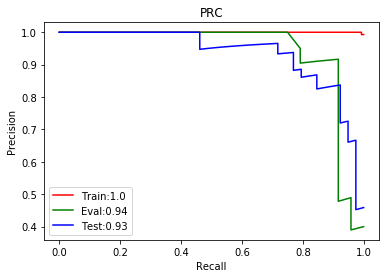

In [30]:
## PRC 
## PRC only valid for binary outcomes. 
## Editing levels < 0.5 are labeled as "0". 
## Editing levels >= 0.5 are labeled as "1". 

from sklearn.metrics import auc, precision_recall_curve

precision_train,recall_train,prc_thresholds_train=precision_recall_curve(train_y>=0.5,train_pred)
precision_eval,recall_eval,prc_thresholds_eval=precision_recall_curve(eval_y>=0.5,eval_pred)
precision_test,recall_test,prc_thresholds_test=precision_recall_curve(test_y>=0.5,test_pred)

auprc_train=auc(recall_train,precision_train)
auprc_eval=auc(recall_eval,precision_eval)
auprc_test=auc(recall_test,precision_test)

plt.plot(recall_train,precision_train,'r',label="Train:"+str(round(auprc_train,2)))
plt.plot(recall_eval,precision_eval,'g',label="Eval:"+str(round(auprc_eval,2)))
plt.plot(recall_test,precision_test,'b',label="Test:"+str(round(auprc_test,2)))
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("PRC")
plt.legend()

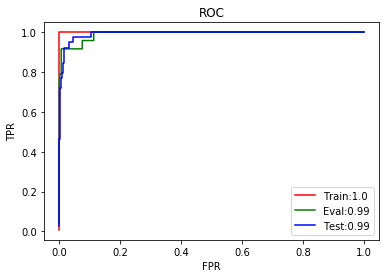

In [31]:
## ROC
from sklearn.metrics import roc_curve, roc_auc_score
fpr_train,tpr_train,roc_thresholds_train=roc_curve(train_y>=0.5,train_pred)
fpr_eval,tpr_eval,roc_thresholds_eval=roc_curve(eval_y>=0.5,eval_pred)
fpr_test,tpr_test,roc_thresholds_test=roc_curve(test_y>=0.5,test_pred)

auroc_train=roc_auc_score(train_y>=0.5,train_pred)
auroc_eval=roc_auc_score(eval_y>=0.5,eval_pred)
auroc_test=roc_auc_score(test_y>=0.5,test_pred)

plt.plot(fpr_train,tpr_train,'r',label="Train:"+str(round(auroc_train,2)))
plt.plot(fpr_eval,tpr_eval,'g',label="Eval:"+str(round(auroc_eval,2)))
plt.plot(fpr_test,tpr_test,'b',label="Test:"+str(round(auroc_test,2)))
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC")
plt.legend()

In [48]:
import plotnine
from plotnine import *
test_df=pd.DataFrame({'Observed':test_y,
                     'Predicted':test_pred,
                     'Dataset':test_dataset})


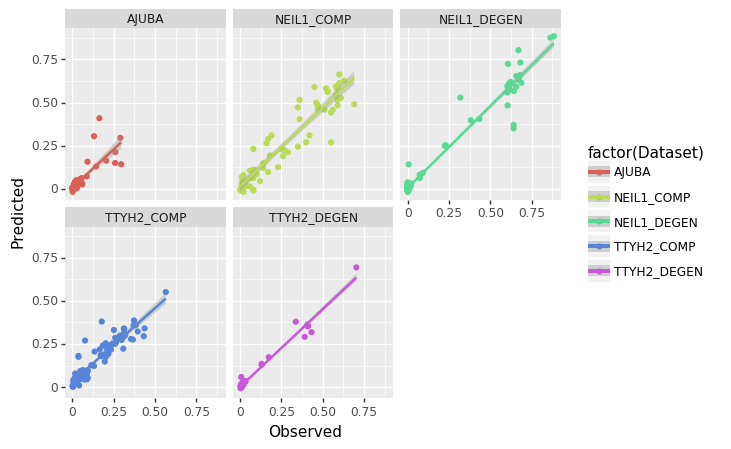

<ggplot: (-9223363248291830044)>

In [53]:
(ggplot(test_df, aes('Observed', 'Predicted', color='factor(Dataset)'))
 + geom_point()
 + stat_smooth(method='lm')
 + facet_wrap('~Dataset'))

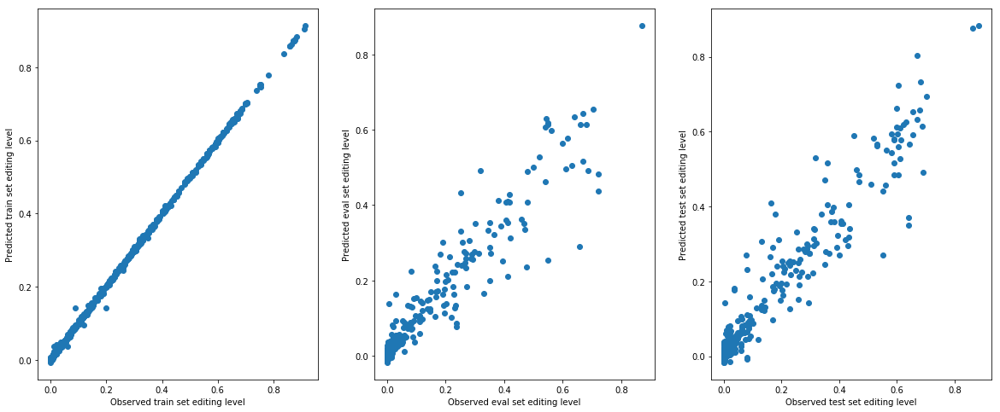

In [45]:
#plot the test set predictions 
matplotlib.rcParams['figure.figsize'] = [20, 8]
plt.subplot(1,3,1)
plt.plot(list(train_y),list(train_pred),'o')
plt.xlabel("Observed train set editing level")
plt.ylabel("Predicted train set editing level")
plt.subplot(1,3,2)
plt.plot(list(eval_y),list(eval_pred),'o')
plt.xlabel("Observed eval set editing level")
plt.ylabel("Predicted eval set editing level")
plt.subplot(1,3,3)
plt.plot(list(test_y),list(test_pred),'o')
plt.xlabel("Observed test set editing level")
plt.ylabel("Predicted test set editing level")

plt.show()

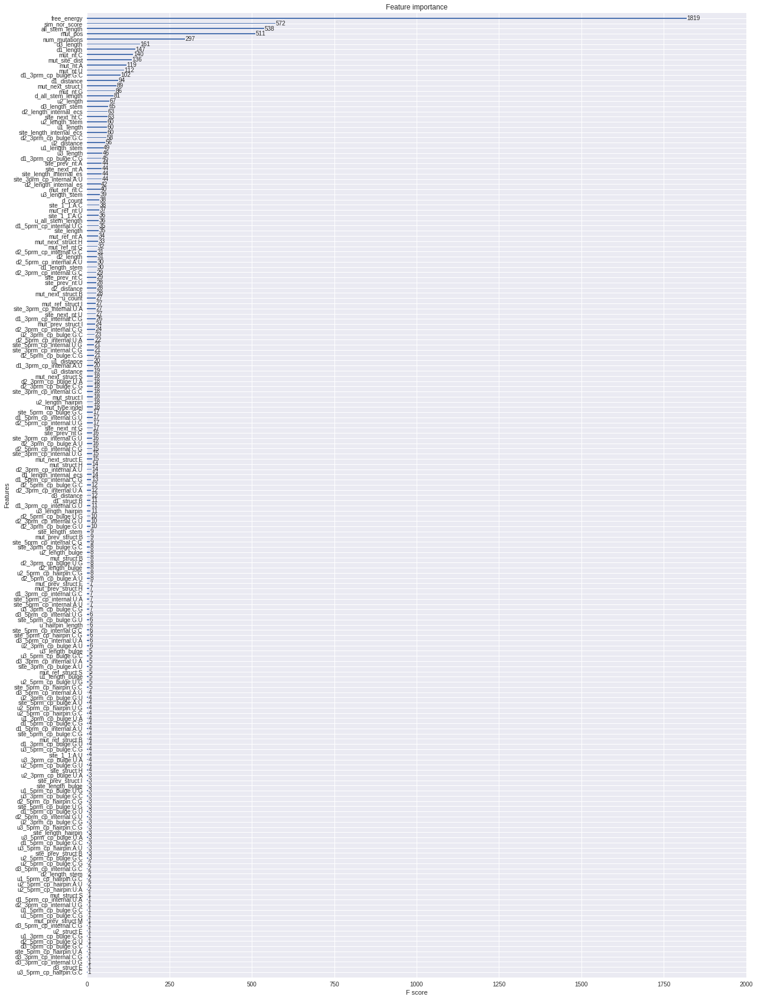

In [30]:
matplotlib.rcParams['figure.figsize'] = [20, 30]
xgboost.plot_importance(bst)

In [0]:
#xgboost.to_graphviz(bst, num_trees=2)


In [31]:
# explain the model's predictions using SHAP values
explainer = shap.TreeExplainer(bst)
shap_values = explainer.shap_values(test_X)
shap_values.shape

(476, 245)

In [32]:
test_y=pd.DataFrame(test_y)
max_index=test_y.index[test_y['editing_value'] == max(test_y['editing_value'])]
max_row=test_y.index.get_loc(max_index[0])
# visualize prediction for isoform with the highest editing level 
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[max_row,:], test_X.iloc[max_row,:])

In [33]:
# visualize prediction for isoform with the lowest editing level 
shap.initjs()
min_index=test_y.index[test_y['editing_value'] == min(test_y['editing_value'])]
min_row=test_y.index.get_loc(min_index[0])
shap.force_plot(explainer.expected_value, shap_values[min_row,:], test_X.iloc[min_row,:])

In [34]:
# visualize the training set predictions
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values,train_X)

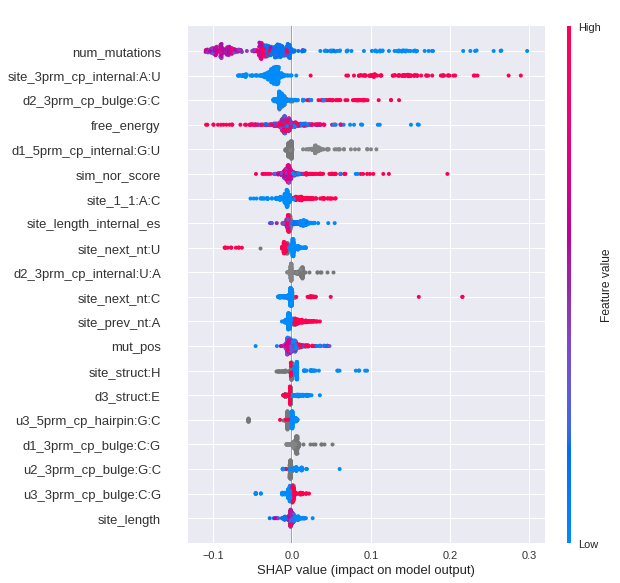

In [35]:
# summarize the effect of all the features 
shap.summary_plot(shap_values, test_X)


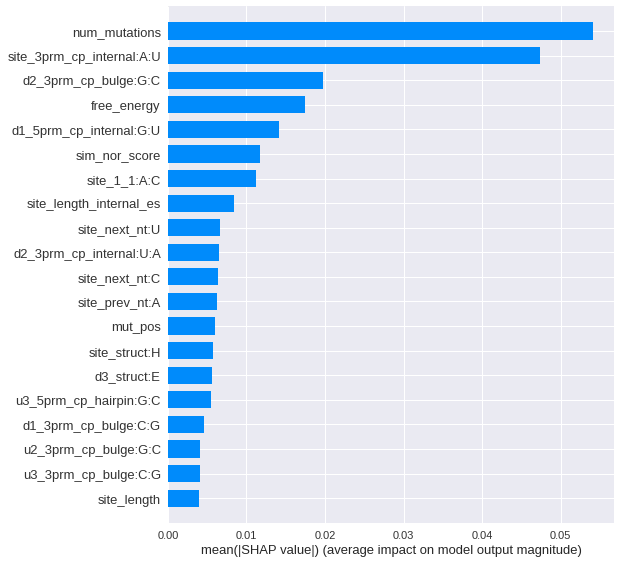

In [36]:
# We can also just take the mean absolute value of the SHAP values for each feature 
# to get a standard bar plot (produces stacked bars for multi-class outputs):
shap.summary_plot(shap_values, test_X, plot_type="bar")

In [37]:
## Compute pairwise interaction values from TreeShap
shap_interaction_values=explainer.shap_interaction_values(test_X)
shap_interaction_values.shape

(476, 245, 245)

In [0]:
##Average interaction values across the datapoints in the test set 
mean_interaction_values=np.mean(shap_interaction_values,axis=0)

In [0]:
Index=test_X.columns
Cols=test_X.columns
mean_interaction_values_df = pd.DataFrame(mean_interaction_values, index=Index, columns=Cols)

In [40]:
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)
configure_plotly_browser_state()

trace = Heatmap(z=mean_interaction_values_df.values,
                   x=Cols,
                   y=Index)
iplot([trace],show_link=False)


##Feature subset<a name='2'>
<a href=#outline>Home</a>

In [0]:
shap_values=pd.DataFrame(shap_values,columns=Cols)

['num_mutations$', 'mut_exist*', 'mut_type*', 'mut_pos*', 'mut_site_dist*', 'mut_ref_nt*', 'mut_ref_struct*', 'mut_nt*', 'mut_struct*', 'mut_prev_struct*', 'mut_next_struct*', 'mut_same_as_site*']


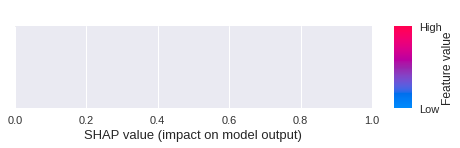

Contribution/Total:0.0
['site_struct*', 'site_prev_nt*', 'site_next_nt*', 'site_prev_struct*', 'site_next_struct*', 'site_1_1_internal*', 'site_length$', 'site_length_stem$', 'site_length_hairpin$', 'site_length_bulge$', 'site_length_internal_es$', 'site_length_internal_ecs$', 'site_5prm_cp_hairpin*', 'site_5prm_cp_bulge*', 'site_3prm_cp_bulge*', 'site_5prm_cp_internal*', 'site_3prm_cp_internal*']


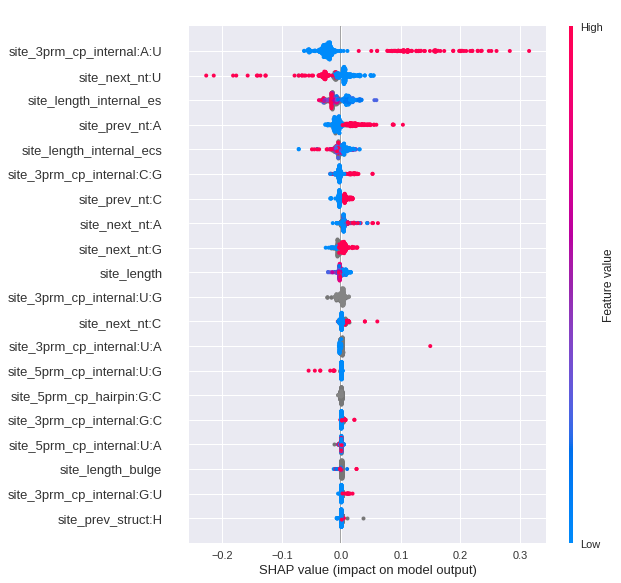

Contribution/Total:0.41901195
['u_count$', 'u_all_stem_length$', 'u_hairpin_length$', 'u1_exist*', 'u1_distance$', 'u1_struct*', 'u1_length$', 'u1_length_stem$', 'u1_length_hairpin$', 'u1_length_bulge$', 'u1_length_internal_es$', 'u1_length_internal_ecs$', 'u1_5prm_cp_hairpin*', 'u1_5prm_cp_bulge*', 'u1_3prm_cp_bulge*', 'u1_5prm_cp_internal*', 'u1_3prm_cp_internal*', 'u2_exist*', 'u2_distance$', 'u2_struct*', 'u2_length$', 'u2_length_stem$', 'u2_length_hairpin$', 'u2_length_bulge$', 'u2_length_internal_es$', 'u2_length_internal_ecs$', 'u2_5prm_cp_hairpin*', 'u2_5prm_cp_bulge*', 'u2_3prm_cp_bulge*', 'u2_5prm_cp_internal*', 'u2_3prm_cp_internal*', 'u3_exist*', 'u3_distance*', 'u3_struct*', 'u3_length$', 'u3_length_stem$', 'u3_length_hairpin$', 'u3_length_bulge$', 'u3_length_internal_es$', 'u3_length_internal_ecs$', 'u3_5prm_cp_hairpin*', 'u3_5prm_cp_bulge*', 'u3_3prm_cp_bulge*', 'u3_5prm_cp_internal*', 'u3_3prm_cp_internal*']


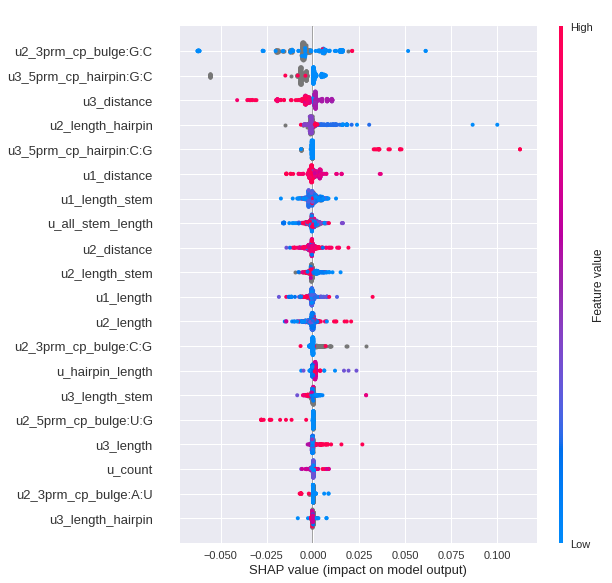

Contribution/Total:0.1322883
['d_count*', 'd_all_stem_length*', 'd1_exist*', 'd1_distance*', 'd1_struct*', 'd1_length$', 'd1_length_stem*', 'd1_length_hairpin*', 'd1_length_bulge*', 'd1_length_internal_es*', 'd1_length_internal_ecs*', 'd1_5prm_cp_hairpin*', 'd1_5prm_cp_bulge*', 'd1_3prm_cp_bulge*', 'd1_5prm_cp_internal*', 'd1_3prm_cp_internal*', 'd2_exist*', 'd2_distance*', 'd2_struct*', 'd2_length$', 'd2_length_stem*', 'd2_length_hairpin*', 'd2_length_bulge*', 'd2_length_internal_es*', 'd2_length_internal_ecs*', 'd2_5prm_cp_hairpin*', 'd2_5prm_cp_bulge*', 'd2_3prm_cp_bulge*', 'd2_5prm_cp_internal*', 'd2_3prm_cp_internal*', 'd3_exist*', 'd3_distance*', 'd3_struct*', 'd3_length$', 'd3_length_stem*', 'd3_length_hairpin*', 'd3_length_bulge*', 'd3_length_internal_es*', 'd3_length_internal_ecs*', 'd3_5prm_cp_hairpin*', 'd3_5prm_cp_bulge*', 'd3_3prm_cp_bulge*', 'd3_5prm_cp_internal*', 'd3_3prm_cp_internal*']


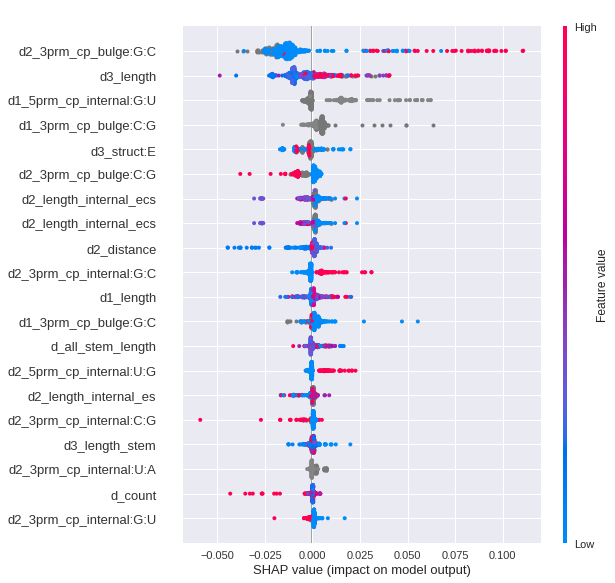

Contribution/Total:0.2703717
['u_count*', 'u_all_stem_length*', 'u_hairpin_length*', 'u1_exist*', 'u1_distance$', 'u1_struct*', 'u1_length$', 'u1_length_stem$', 'u1_length_hairpin$', 'u1_length_bulge$', 'u1_length_internal_es$', 'u1_length_internal_ecs$', 'u1_5prm_cp_hairpin*', 'u1_5prm_cp_bulge*', 'u1_3prm_cp_bulge*', 'u1_5prm_cp_internal*', 'u1_3prm_cp_internal*', 'u2_exist*', 'u2_distance$', 'u2_struct*', 'u2_length$', 'u2_length_stem$', 'u2_length_hairpin$', 'u2_length_bulge$', 'u2_length_internal_es$', 'u2_length_internal_ecs$', 'u2_5prm_cp_hairpin*', 'u2_5prm_cp_bulge*', 'u2_3prm_cp_bulge*', 'u2_5prm_cp_internal*', 'u2_3prm_cp_internal*', 'u3_exist*', 'u3_distance*', 'u3_struct*', 'u3_length$', 'u3_length_stem$', 'u3_length_hairpin$', 'u3_length_bulge$', 'u3_length_internal_es$', 'u3_length_internal_ecs$', 'u3_5prm_cp_hairpin*', 'u3_5prm_cp_bulge*', 'u3_3prm_cp_bulge*', 'u3_5prm_cp_internal*', 'u3_3prm_cp_internal*', 'd_count*', 'd_all_stem_length*', 'd1_exist*', 'd1_distance*', 

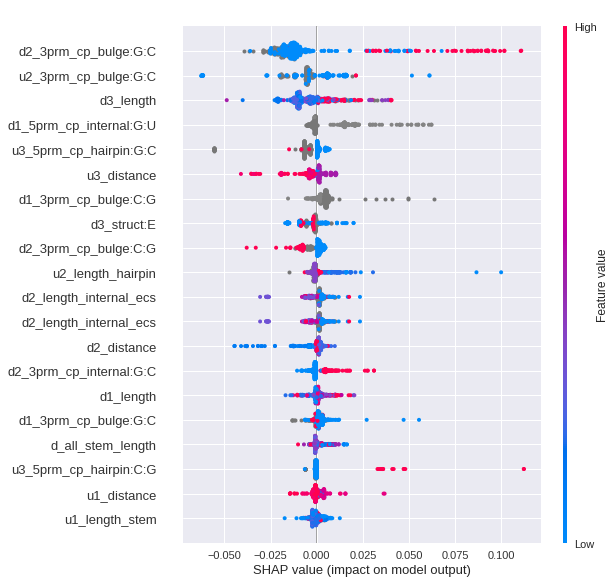

Contribution/Total:0.40266
['num_mutations*', 'mut_exist*', 'mut_type*', 'mut_pos*', 'mut_site_dist*', 'mut_ref_nt*', 'mut_ref_struct*', 'mut_nt*', 'mut_struct*', 'mut_prev_struct*', 'mut_next_struct*', 'mut_same_as_site*', 'site_prev_nt*', 'site_next_nt*', 'site_prev_struct*', 'site_next_struct*', 'site_1_1_internal*', 'site_length$', 'site_length_stem$', 'site_length_hairpin$', 'site_length_bulge$', 'site_length_internal_es$', 'site_length_internal_ecs$', 'site_5prm_cp_hairpin*', 'site_5prm_cp_bulge*', 'site_3prm_cp_bulge*', 'site_5prm_cp_internal*', 'site_3prm_cp_internal*']


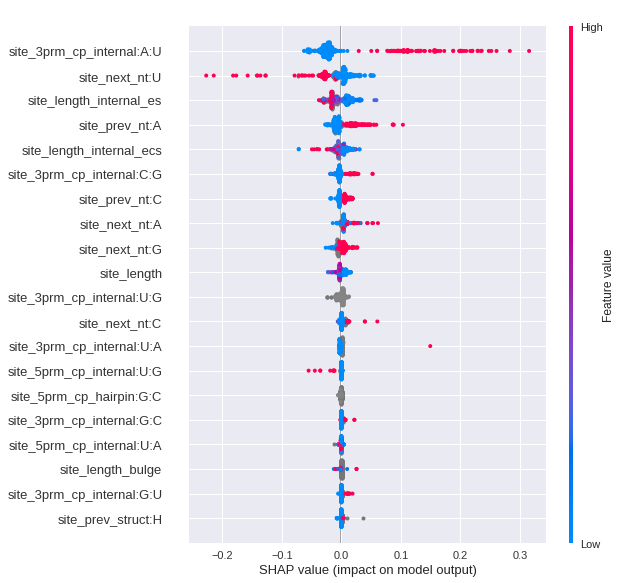

Contribution/Total:0.41901195
['num_mutations*', 'mut_exist*', 'mut_type*', 'mut_pos*', 'mut_site_dist*', 'mut_ref_nt*', 'mut_ref_struct*', 'mut_nt*', 'mut_struct*', 'mut_prev_struct*', 'mut_next_struct*', 'mut_same_as_site*', 'site_struct*', 'site_prev_nt*', 'site_next_nt*', 'site_prev_struct*', 'site_next_struct*', 'site_1_1_internal*', 'site_length$', 'site_length_stem$', 'site_length_hairpin$', 'site_length_bulge$', 'site_length_internal_es$', 'site_length_internal_ecs$', 'site_5prm_cp_hairpin*', 'site_5prm_cp_bulge*', 'site_3prm_cp_bulge*', 'site_5prm_cp_internal*', 'site_3prm_cp_internal*', 'd_count*', 'd_all_stem_length*', 'd1_exist*', 'd1_distance*', 'd1_struct*', 'd1_length$', 'd1_length_stem*', 'd1_length_hairpin*', 'd1_length_bulge*', 'd1_length_internal_es*', 'd1_length_internal_ecs*', 'd1_5prm_cp_hairpin*', 'd1_5prm_cp_bulge*', 'd1_3prm_cp_bulge*', 'd1_5prm_cp_internal*', 'd1_3prm_cp_internal*', 'd2_exist*', 'd2_distance*', 'd2_struct*', 'd2_length$', 'd2_length_stem*', 'd

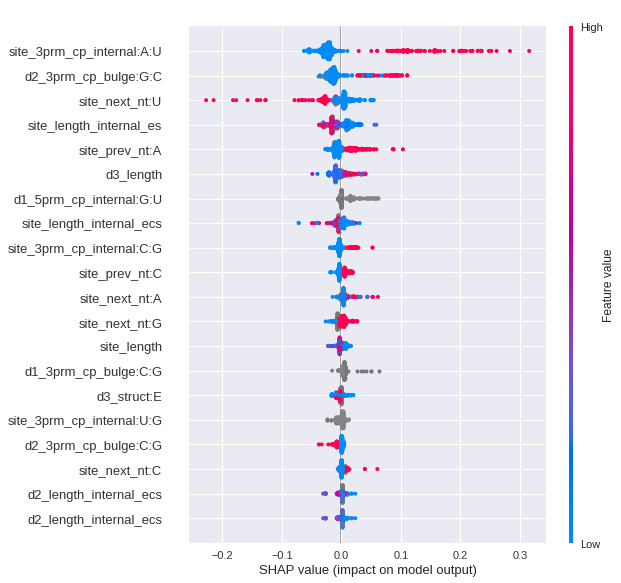

Contribution/Total:0.6893837
['num_mutations*', 'mut_exist*', 'mut_type*', 'mut_pos*', 'mut_site_dist*', 'mut_ref_nt*', 'mut_ref_struct*', 'mut_nt*', 'mut_struct*', 'mut_prev_struct*', 'mut_next_struct*', 'mut_same_as_site*', 'site_struct*', 'site_prev_nt*', 'site_next_nt*', 'site_prev_struct*', 'site_next_struct*', 'site_1_1_internal*', 'site_length$', 'site_length_stem$', 'site_length_hairpin$', 'site_length_bulge$', 'site_length_internal_es$', 'site_length_internal_ecs$', 'site_5prm_cp_hairpin*', 'site_5prm_cp_bulge*', 'site_3prm_cp_bulge*', 'site_5prm_cp_internal*', 'site_3prm_cp_internal*', 'u_count$', 'u_all_stem_length$', 'u_hairpin_length$', 'u1_exist*', 'u1_distance$', 'u1_struct*', 'u1_length$', 'u1_length_stem$', 'u1_length_hairpin$', 'u1_length_bulge$', 'u1_length_internal_es$', 'u1_length_internal_ecs$', 'u1_5prm_cp_hairpin*', 'u1_5prm_cp_bulge*', 'u1_3prm_cp_bulge*', 'u1_5prm_cp_internal*', 'u1_3prm_cp_internal*', 'u2_exist*', 'u2_distance$', 'u2_struct*', 'u2_length$', '

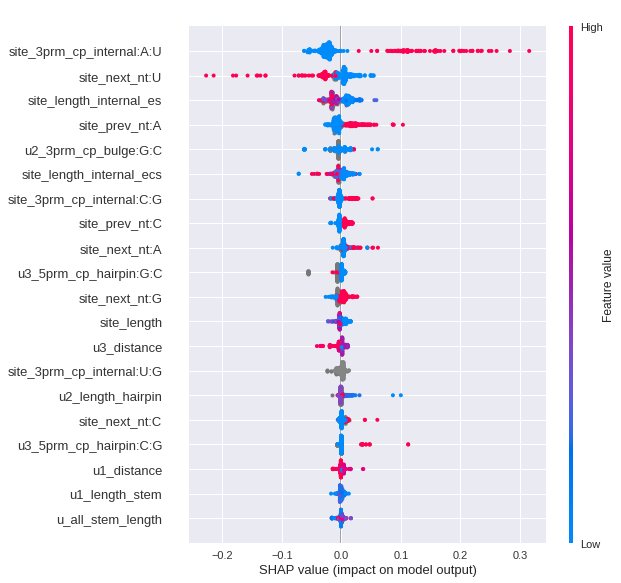

Contribution/Total:0.5513003
['site_struct$', 'site_length$', 'site_length_internal_es$', 'site_length_internal_ecs$', 'site_3prm_cp_internal*']


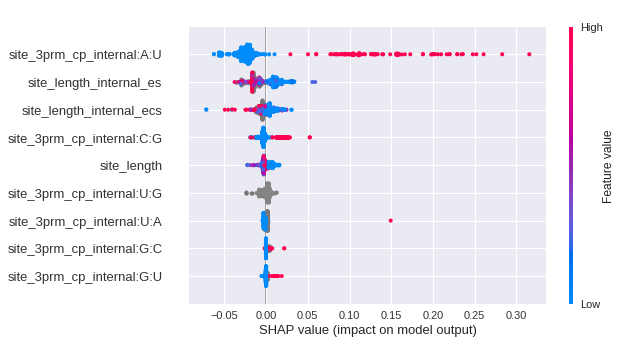

Contribution/Total:0.25089955
['site_prev_nt*', 'site_next_nt*', 'site_1_1_internal*']


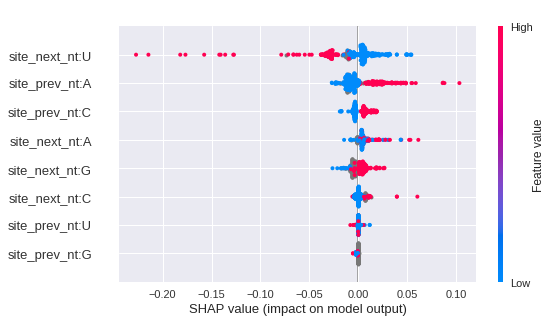

Contribution/Total:0.14825308
['num_mutations$', 'mut_pos$', 'mut_site_dist$', 'mut_ref_nt*', 'mut_nt*']


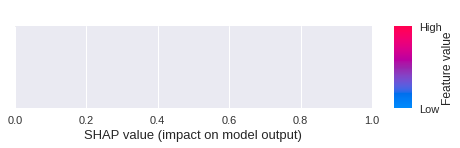

Contribution/Total:0.0
['site_prev_nt*', 'site_next_nt*', 'num_mutations', 'mut_pos', 'mut_site_dist', 'mut_ref_nt*', 'mut_nt*']


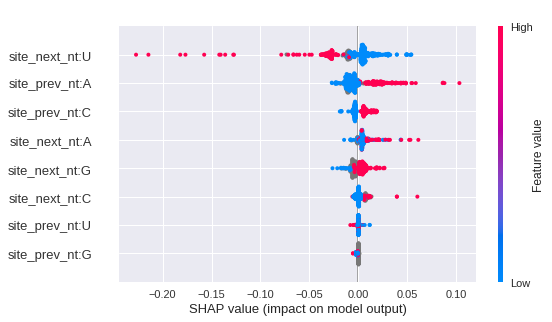

Contribution/Total:0.14825308
['free_energy*', '^all_stem_length$', 'site_struct*', 'site_prev_nt*', 'site_next_nt*', 'site_prev_struct*', 'site_next_struct*', 'site_1_1_internal*', 'site_length$', 'site_length_stem$', 'site_length_hairpin$', 'site_length_bulge$', 'site_length_internal_es$', 'site_length_internal_ecs$', 'site_5prm_cp_hairpin*', 'site_5prm_cp_bulge*', 'site_3prm_cp_bulge*', 'site_5prm_cp_internal*', 'site_3prm_cp_internal*', 'u_count$', 'u_all_stem_length$', 'u_hairpin_length$', 'u1_exist*', 'u1_distance$', 'u1_struct*', 'u1_length$', 'u1_length_stem$', 'u1_length_hairpin$', 'u1_length_bulge$', 'u1_length_internal_es$', 'u1_length_internal_ecs$', 'u1_5prm_cp_hairpin*', 'u1_5prm_cp_bulge*', 'u1_3prm_cp_bulge*', 'u1_5prm_cp_internal*', 'u1_3prm_cp_internal*', 'u2_exist*', 'u2_distance$', 'u2_struct*', 'u2_length$', 'u2_length_stem$', 'u2_length_hairpin$', 'u2_length_bulge$', 'u2_length_internal_es$', 'u2_length_internal_ecs$', 'u2_5prm_cp_hairpin*', 'u2_5prm_cp_bulge*', '

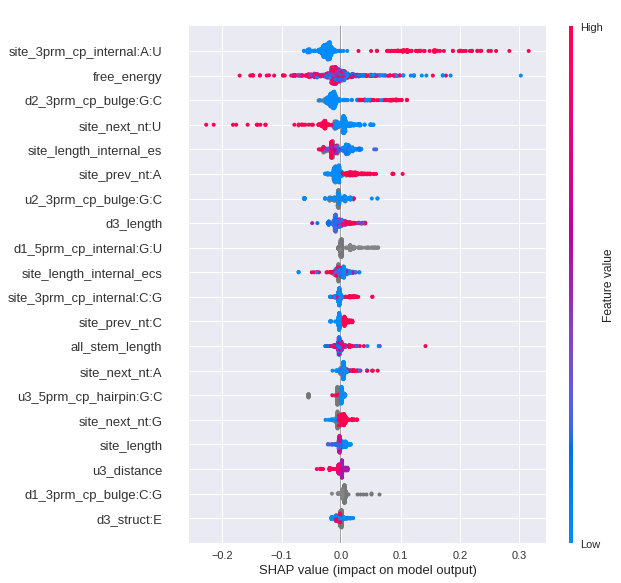

Contribution/Total:0.92375815
['free_energy*', '^all_stem_length$']


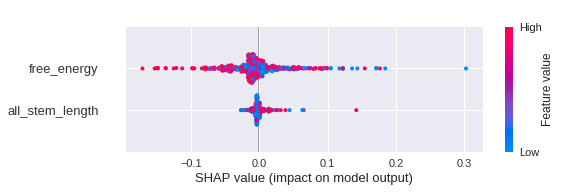

Contribution/Total:0.10208622


In [75]:
from feature_subsets import * 
for subset in [mut,site,u,d,u_d,mut_site,no_up,no_down,site_struct,site_seq,mut_seq,mut_seq_site,no_mut,overall_structure]: 
  print(subset)
  cur_features=filter_features(shap_values,subset)
  cur_feature_shap=shap_values[cur_features].values 
  cur_feature_test_X=test_X[cur_features]
  shap.summary_plot(cur_feature_shap, cur_feature_test_X)#,sort=False,max_display=50)
  print("Contribution/Total:"+str(shap_contribs_subgroup(shap_values,subset)))

## No "mut" features

In [0]:
## Read in the data 
import feature_subsets
import pandas as pd 

#drop all mut features in train split 
cur_features=filter_features(train_split,feature_subsets.mut)
cur_features.remove('mut_pos')
train_split=train_split.drop(cur_features,axis=1)

#drop all mut features in eval split 
cur_features=filter_features(eval_split,feature_subsets.mut)
cur_features.remove('mut_pos')
eval_split=eval_split.drop(cur_features,axis=1)


#drop all mut features in test split 
cur_features=filter_features(test_split,feature_subsets.mut)
cur_features.remove('mut_pos')
test_split=test_split.drop(cur_features,axis=1)

In [0]:
train_y=train_split['editing_value']
train_X=train_split.drop(['editing_value','mut_pos'],axis=1)

eval_y=eval_split['editing_value']
eval_X=eval_split.drop(['editing_value','mut_pos'],axis=1)

test_y=test_split['editing_value']
test_X=test_split.drop(['editing_value','mut_pos'],axis=1)

In [49]:
print(train_X.shape)
print(train_y.shape)
print(eval_X.shape)
print(eval_y.shape)
print(test_X.shape)
print(test_y.shape)


(1741, 215)
(1741,)
(342, 215)
(342,)
(476, 215)
(476,)


In [0]:
## format matrixes for xgboost 
import xgboost
dtrain=xgboost.DMatrix(train_X,train_y)
deval=xgboost.DMatrix(eval_X,eval_y)
dtest=xgboost.DMatrix(test_X,test_y)

In [0]:
## set model training parameters 
param=dict() 
param['nthread'] = 20
#rmse -- root mean square error 
# mae -- mean absolute error 
# map -- mean average precision 
# auc -- area under ROC curve 
# aucpr -- area under precision recall curve 
param['eval_metric'] = ['auc','mae','map','aucpr','rmse']

In [0]:
evallist = [(deval, 'eval'), (dtrain, 'train')]


In [53]:
num_round = 1000
bst = xgboost.train(param, dtrain, num_round, evallist,early_stopping_rounds=10)

[22:29:11] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 70 extra nodes, 0 pruned nodes, max_depth=6
[0]	eval-auc:0.847188	eval-mae:0.285973	eval-map:1	eval-aucpr:0.450284	eval-rmse:0.304597	train-auc:0.854243	train-mae:0.288448	train-map:1	train-aucpr:0.499273	train-rmse:0.305433
Multiple eval metrics have been passed: 'train-rmse' will be used for early stopping.

Will train until train-rmse hasn't improved in 10 rounds.
[22:29:12] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 78 extra nodes, 0 pruned nodes, max_depth=6
[1]	eval-auc:0.865663	eval-mae:0.209344	eval-map:1	eval-aucpr:0.467718	eval-rmse:0.223374	train-auc:0.866465	train-mae:0.20995	train-map:1	train-aucpr:0.515551	train-rmse:0.222828
[22:29:12] /workspace/src/tree/updater_prune.cc:74: tree pruning end, 1 roots, 78 extra nodes, 0 pruned nodes, max_depth=6
[2]	eval-auc:0.873792	eval-mae:0.156584	eval-map:1	eval-aucpr:0.476962	eval-rmse:0.16847	train-auc:0.876867	train-mae:0.15595

In [0]:
# save to binary file for faster loading
bst.save_model('combined.substratres.nomutfeatures.model')
# save model to text file 
bst.dump_model('combined.substrate.nomutfeatures.raw.txt')


In [0]:
## get model predictions on the test, training, and eval splits 
test_pred = bst.predict(dtest)
train_pred=bst.predict(dtrain)
eval_pred=bst.predict(deval)

In [56]:
## Correlation values 
from scipy.stats import spearmanr,pearsonr
spearman_train=spearmanr(train_y,train_pred)
spearman_eval=spearmanr(eval_y,eval_pred)
spearman_test=spearmanr(test_y,test_pred)

pearson_train=pearsonr(train_y,train_pred)
pearson_eval=pearsonr(eval_y,eval_pred)
pearson_test=pearsonr(test_y,test_pred)

print("Spearman correlation:")
print("Train:"+str(spearman_train))
print("Eval:"+str(spearman_eval))
print("Test:"+str(spearman_test))
print("\n")
print("Pearson correlation:")
print("Train:"+str(pearson_train))
print("Eval:"+str(pearson_eval))
print("Test:"+str(pearson_test))

Spearman correlation:
Train:SpearmanrResult(correlation=0.9922691345666417, pvalue=0.0)
Eval:SpearmanrResult(correlation=0.9534806069051395, pvalue=3.906403454381025e-179)
Test:SpearmanrResult(correlation=0.9543328475085135, pvalue=7.530374982223264e-251)


Pearson correlation:
Train:(0.9989402313605114, 0.0)
Eval:(0.927671461364692, 1.6089479088608444e-147)
Test:(0.937890544273861, 4.644683527689461e-220)


In [57]:
## MAE
from sklearn.metrics import mean_absolute_error
mae_train=mean_absolute_error(train_y,train_pred)
print("MAE Train:"+str(mae_train))

mae_eval=mean_absolute_error(eval_y,eval_pred)
print("MAE Eval:"+str(mae_eval))

mae_test=mean_absolute_error(test_y,test_pred)
print("MAE Test:"+str(mae_test))


MAE Train:0.0023980214156864668
MAE Eval:0.025853233037188336
MAE Test:0.022274763229514365


In [58]:
## MAPE
pseudocount=0.01
mape_train=np.mean(np.abs((train_y - train_pred) /(pseudocount+train_y))) * 100
print("MAPE Train:"+str(mape_train)+"%")

mape_eval=np.mean(np.abs((eval_y - eval_pred) /(pseudocount+eval_y))) * 100
print("MAPE Eval:"+str(mape_eval)+"%")

mape_test=np.mean(np.abs((test_y - test_pred) /(pseudocount+test_y))) * 100
print("MAPE Test:"+str(mape_test)+"%")

MAPE Train:4.248604738490846%
MAPE Eval:34.41261739694774%
MAPE Test:28.668917233797668%


In [59]:
## RMSE
from sklearn.metrics import mean_squared_error
import math 
rmse_train=math.sqrt(mean_squared_error(train_y,train_pred))
print("RMSE Train:"+str(rmse_train))

rmse_eval=math.sqrt(mean_squared_error(eval_y,eval_pred))
print("RMSE Eval:"+str(rmse_eval))

rmse_test=math.sqrt(mean_squared_error(test_y,test_pred))
print("RMSE Test:"+str(rmse_test))


RMSE Train:0.008771808761788435
RMSE Eval:0.06909684871305354
RMSE Test:0.0657938216455873


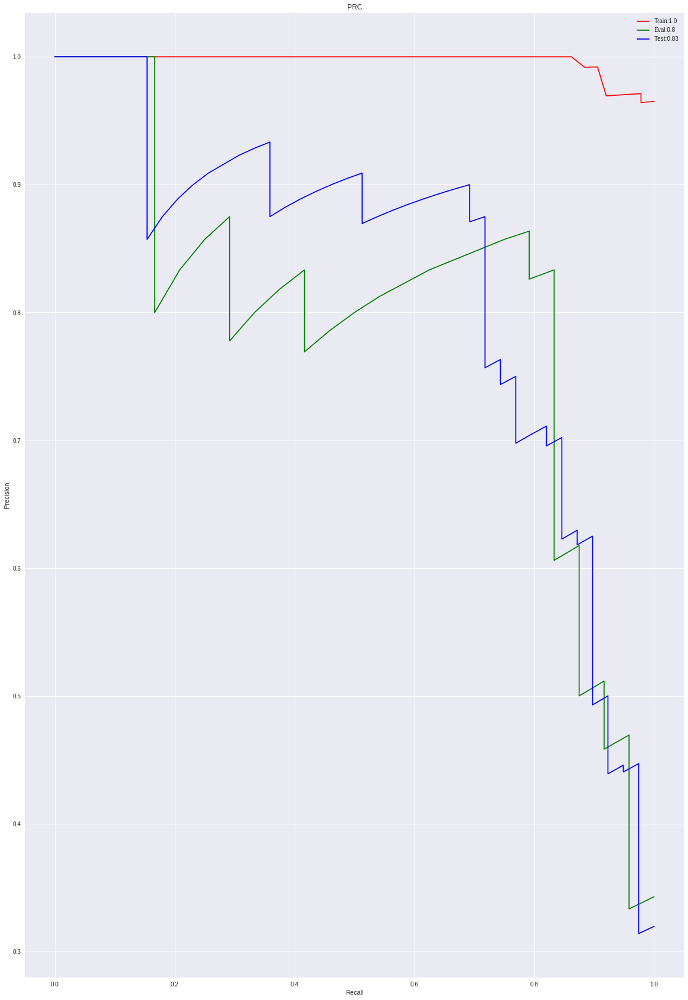

In [60]:
## PRC 
## PRC only valid for binary outcomes. 
## Editing levels < 0.5 are labeled as "0". 
## Editing levels >= 0.5 are labeled as "1". 

from sklearn.metrics import auc, precision_recall_curve

precision_train,recall_train,prc_thresholds_train=precision_recall_curve(train_y>=0.5,train_pred)
precision_eval,recall_eval,prc_thresholds_eval=precision_recall_curve(eval_y>=0.5,eval_pred)
precision_test,recall_test,prc_thresholds_test=precision_recall_curve(test_y>=0.5,test_pred)

auprc_train=auc(recall_train,precision_train)
auprc_eval=auc(recall_eval,precision_eval)
auprc_test=auc(recall_test,precision_test)

plt.plot(recall_train,precision_train,'r',label="Train:"+str(round(auprc_train,2)))
plt.plot(recall_eval,precision_eval,'g',label="Eval:"+str(round(auprc_eval,2)))
plt.plot(recall_test,precision_test,'b',label="Test:"+str(round(auprc_test,2)))
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("PRC")
plt.legend()

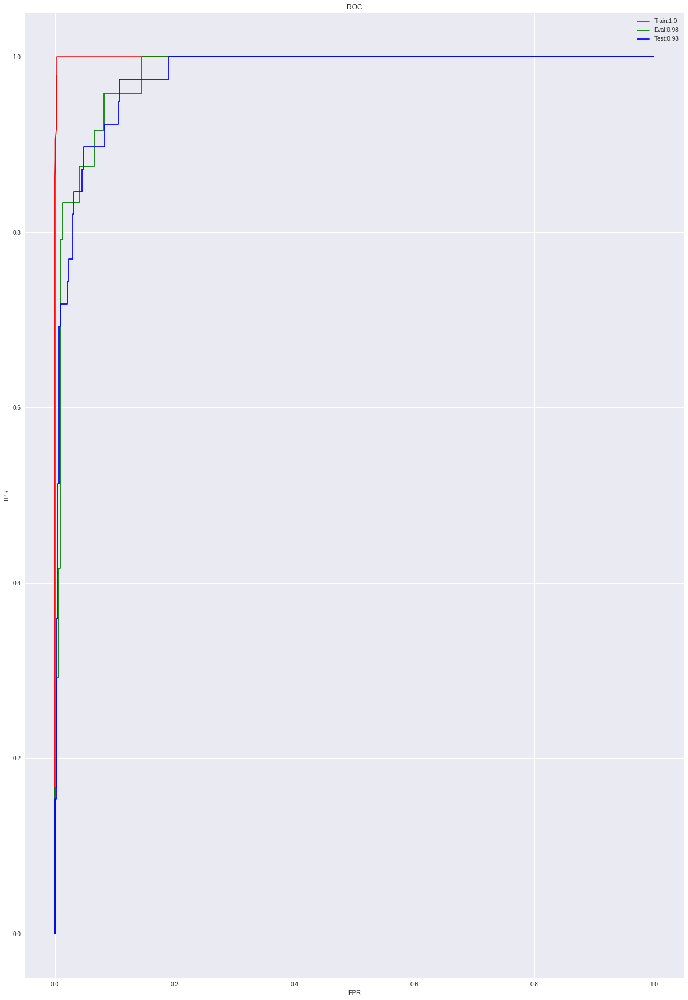

In [61]:
## ROC
from sklearn.metrics import roc_curve, roc_auc_score
fpr_train,tpr_train,roc_thresholds_train=roc_curve(train_y>=0.5,train_pred)
fpr_eval,tpr_eval,roc_thresholds_eval=roc_curve(eval_y>=0.5,eval_pred)
fpr_test,tpr_test,roc_thresholds_test=roc_curve(test_y>=0.5,test_pred)

auroc_train=roc_auc_score(train_y>=0.5,train_pred)
auroc_eval=roc_auc_score(eval_y>=0.5,eval_pred)
auroc_test=roc_auc_score(test_y>=0.5,test_pred)

plt.plot(fpr_train,tpr_train,'r',label="Train:"+str(round(auroc_train,2)))
plt.plot(fpr_eval,tpr_eval,'g',label="Eval:"+str(round(auroc_eval,2)))
plt.plot(fpr_test,tpr_test,'b',label="Test:"+str(round(auroc_test,2)))
plt.xlabel("FPR")
plt.ylabel("TPR")
plt.title("ROC")
plt.legend()

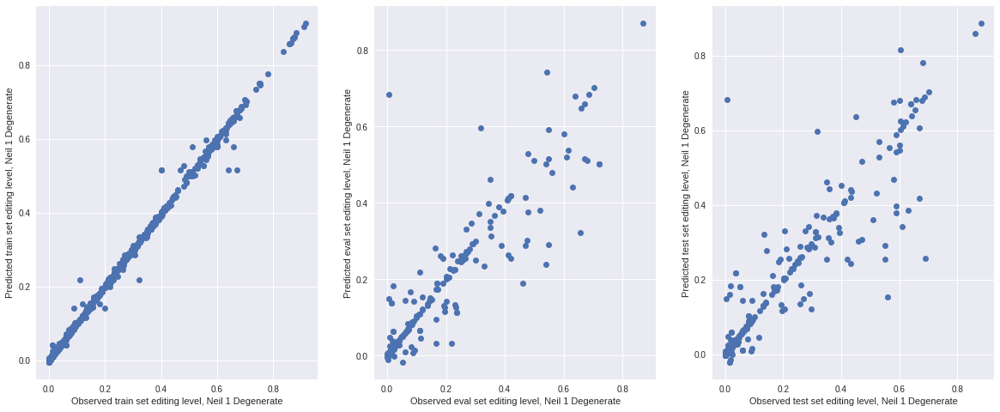

In [62]:
#plot the test set predictions 
matplotlib.rcParams['figure.figsize'] = [20, 8]
plt.subplot(1,3,1)
plt.plot(list(train_y),list(train_pred),'o')
plt.xlabel("Observed train set editing level, Neil 1 Degenerate")
plt.ylabel("Predicted train set editing level, Neil 1 Degenerate")
plt.subplot(1,3,2)
plt.plot(list(eval_y),list(eval_pred),'o')
plt.xlabel("Observed eval set editing level, Neil 1 Degenerate")
plt.ylabel("Predicted eval set editing level, Neil 1 Degenerate")
plt.subplot(1,3,3)
plt.plot(list(test_y),list(test_pred),'o')
plt.xlabel("Observed test set editing level, Neil 1 Degenerate")
plt.ylabel("Predicted test set editing level, Neil 1 Degenerate")

plt.show()

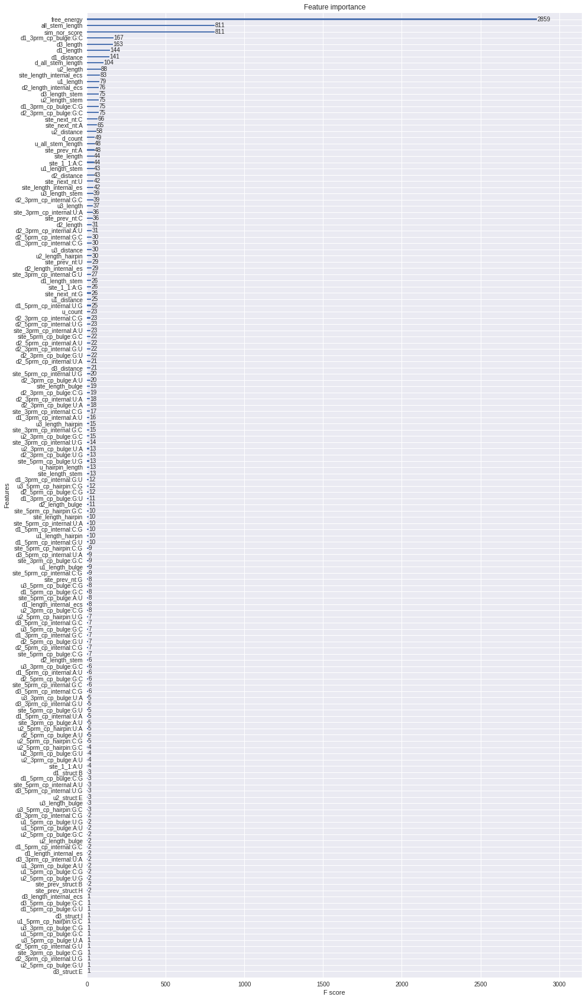

In [63]:
matplotlib.rcParams['figure.figsize'] = [15, 30]
xgboost.plot_importance(bst)

In [0]:
#xgboost.to_graphviz(bst, num_trees=2)


In [64]:
# explain the model's predictions using SHAP values
explainer = shap.TreeExplainer(bst)
shap_values = explainer.shap_values(test_X)
shap_values.shape

(476, 215)

In [65]:
test_y=pd.DataFrame(test_y)
max_index=test_y.index[test_y['editing_value'] == max(test_y['editing_value'])]
max_row=test_y.index.get_loc(max_index[0])
# visualize prediction for isoform with the highest editing level 
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[max_row,:], test_X.iloc[max_row,:])

In [66]:
# visualize prediction for isoform with the lowest editing level 
shap.initjs()
min_index=test_y.index[test_y['editing_value'] == min(test_y['editing_value'])]
min_row=test_y.index.get_loc(min_index[0])
shap.force_plot(explainer.expected_value, shap_values[min_row,:], test_X.iloc[min_row,:])

In [67]:
# visualize the training set predictions
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values,train_X)

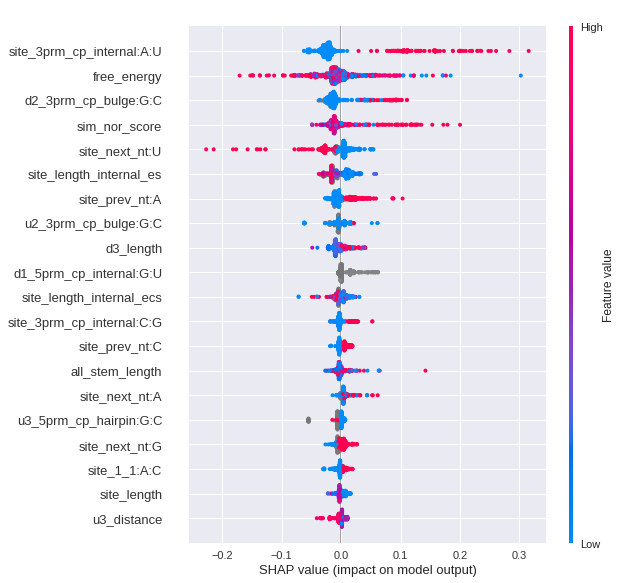

In [68]:
# summarize the effect of all the features 
shap.summary_plot(shap_values, test_X)


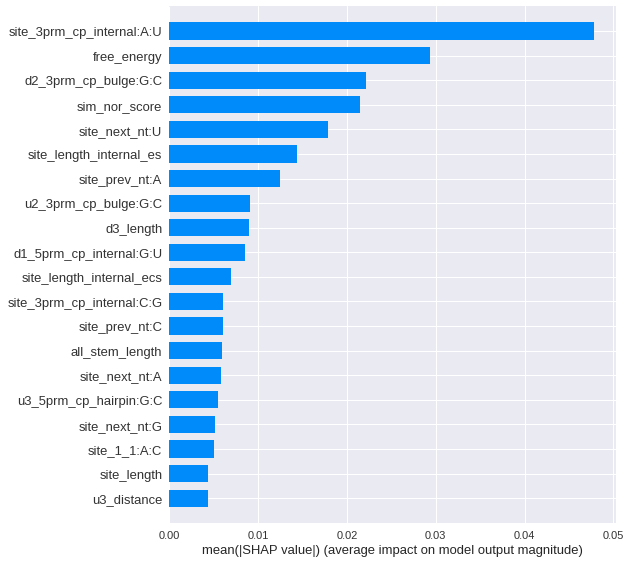

In [69]:
# We can also just take the mean absolute value of the SHAP values for each feature 
# to get a standard bar plot (produces stacked bars for multi-class outputs):
shap.summary_plot(shap_values, test_X, plot_type="bar")

In [70]:
## Compute pairwise interaction values from TreeShap
shap_interaction_values=explainer.shap_interaction_values(test_X)
shap_interaction_values.shape

(476, 215, 215)

In [0]:
##Average interaction values across the datapoints in the test set 
mean_interaction_values=np.mean(shap_interaction_values,axis=0)

In [0]:
Index=test_X.columns
Cols=test_X.columns
mean_interaction_values_df = pd.DataFrame(mean_interaction_values, index=Index, columns=Cols)

In [73]:
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)
configure_plotly_browser_state()

trace = Heatmap(z=mean_interaction_values_df.values,
                   x=Cols,
                   y=Index)
iplot([trace],show_link=False)
